## Process:


- Downloaded and unzipped the MURED dataset.
- Performed data loading and EDA
- Data Pre-processing
- Built multiple deep learning models (a custom DeepCNN, VGG16, VGG19, EfficientNetB7, DenseNet169, MobileNet, and a Vision Transformer).
- Trained and evaluated each model using accuracy, precision, recall, F1-score, and ROC-AUC.
- Visulaized model performances with bar charts.
- Saved the best model (Vision Transformer) as a PyTorch model.
- Created a user interface with Flask to upload images and display predictions along with treatment suggestions.


# Section 1: Data Setup

In [ ]:
# Download the dataset and save it as MURED.zip
!wget -O MURED.zip "https://prod-dcd-datasets-cache-zipfiles.s3.eu-west-1.amazonaws.com/pc4mb3h8hz-1.zip"

!unzip -q MURED.zip


--2025-03-09 13:48:53--  https://prod-dcd-datasets-cache-zipfiles.s3.eu-west-1.amazonaws.com/pc4mb3h8hz-1.zip
Resolving prod-dcd-datasets-cache-zipfiles.s3.eu-west-1.amazonaws.com (prod-dcd-datasets-cache-zipfiles.s3.eu-west-1.amazonaws.com)... 3.5.71.249, 52.92.18.10, 3.5.68.175, ...
Connecting to prod-dcd-datasets-cache-zipfiles.s3.eu-west-1.amazonaws.com (prod-dcd-datasets-cache-zipfiles.s3.eu-west-1.amazonaws.com)|3.5.71.249|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 5438656680 (5.1G) [application/zip]
Saving to: ‘MURED.zip’

MURED.zip           100%[===================>]   5.06G  16.6MB/s    in 5m 17s  

2025-03-09 13:54:11 (16.4 MB/s) - ‘MURED.zip’ saved [5438656680/5438656680]



In [ ]:

!unzip /content/Multi-Label\ Retinal\ Diseases\ \(MuReD\)\ Dataset/images.zip -d /content/Multi-Label\ Retinal\ Diseases\ \(MuReD\)\ Dataset/


Archive:  /content/Multi-Label Retinal Diseases (MuReD) Dataset/images.zip
   creating: /content/Multi-Label Retinal Diseases (MuReD) Dataset/images/
  inflating: /content/Multi-Label Retinal Diseases (MuReD) Dataset/images/(0001)aria_d_27.tif  
  inflating: /content/Multi-Label Retinal Diseases (MuReD) Dataset/images/(0031)aria_c_37.tif  
  inflating: /content/Multi-Label Retinal Diseases (MuReD) Dataset/images/aria_a_10_27.tif  
  inflating: /content/Multi-Label Retinal Diseases (MuReD) Dataset/images/aria_a_14_11.tif  
  inflating: /content/Multi-Label Retinal Diseases (MuReD) Dataset/images/aria_a_20_6.tif  
  inflating: /content/Multi-Label Retinal Diseases (MuReD) Dataset/images/aria_a_26_10.tif  
  inflating: /content/Multi-Label Retinal Diseases (MuReD) Dataset/images/aria_a_34_6.tif  
  inflating: /content/Multi-Label Retinal Diseases (MuReD) Dataset/images/aria_a_46_14.tif  
  inflating: /content/Multi-Label Retinal Diseases (MuReD) Dataset/images/aria_a_9_43.tif  
  inflatin

In [ ]:

# Removing the zip files
!rm /content/MURED.zip
!rm -r /content/Multi-Label\ Retinal\ Diseases\ \(MuReD\)\ Dataset/images.zip

# Section 2: EDA

In [ ]:
import pandas as pd

# Load the datasets
train_df = pd.read_csv('/content/Multi-Label Retinal Diseases (MuReD) Dataset/train_data.csv')
val_df = pd.read_csv('/content/Multi-Label Retinal Diseases (MuReD) Dataset/val_data.csv')

# Print info and top 5 rows for the training dataset
print("Training Dataset Info:")
print(train_df.info())
print("\nTraining Dataset Top 5 Rows:")
print(train_df.head())

# Print info and top 5 rows for the validation dataset
print("\nValidation Dataset Info:")
print(val_df.info())
print("\nValidation Dataset Top 5 Rows:")
print(val_df.head())


Training Dataset Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1764 entries, 0 to 1763
Data columns (total 21 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   ID      1764 non-null   object
 1   DR      1764 non-null   int64 
 2   NORMAL  1764 non-null   int64 
 3   MH      1764 non-null   int64 
 4   ODC     1764 non-null   int64 
 5   TSLN    1764 non-null   int64 
 6   ARMD    1764 non-null   int64 
 7   DN      1764 non-null   int64 
 8   MYA     1764 non-null   int64 
 9   BRVO    1764 non-null   int64 
 10  ODP     1764 non-null   int64 
 11  CRVO    1764 non-null   int64 
 12  CNV     1764 non-null   int64 
 13  RS      1764 non-null   int64 
 14  ODE     1764 non-null   int64 
 15  LS      1764 non-null   int64 
 16  CSR     1764 non-null   int64 
 17  HTR     1764 non-null   int64 
 18  ASR     1764 non-null   int64 
 19  CRS     1764 non-null   int64 
 20  OTHER   1764 non-null   int64 
dtypes: int64(20), object(1)
memory usage:

In [ ]:
# print folder hierarchy and immediate files of /content/Multi-Label Retinal Diseases (MuReD) Dataset also printing around 10 file names from /content/Multi-Label Retinal Diseases (MuReD) Dataset/images (in same hierarchy)

import os
import pandas as pd

def print_folder_hierarchy(path, level=0):
    for item in os.listdir(path):
        item_path = os.path.join(path, item)
        print("  " * level + "- " + item)
        if os.path.isdir(item_path):
            print_folder_hierarchy(item_path, level + 1)

print("Folder Hierarchy and Immediate Files of /content/Multi-Label Retinal Diseases (MuReD) Dataset:")
print_folder_hierarchy("/content/Multi-Label Retinal Diseases (MuReD) Dataset")



Folder Hierarchy and Immediate Files of /content/Multi-Label Retinal Diseases (MuReD) Dataset:
- val_data.csv
- images
  - 507.png
  - 4.png
  - 729.png
  - 1820.png
  - 370.png
  - im0205.png
  - 1558.png
  - 1541.png
  - 1881.png
  - 1845.png
  - 821.png
  - 1043.png
  - 784.png
  - 890.png
  - 950.png
  - 1651.png
  - 1407.png
  - 1338.png
  - 1296.png
  - 878.png
  - im0268.png
  - 1738.png
  - 799.png
  - 1408.png
  - 976.png
  - im0212.png
  - 1303.png
  - 1062.png
  - im0079.png
  - 122.png
  - 1274.png
  - im0044.png
  - im0307.png
  - 268.png
  - 63.png
  - 1789.png
  - 1653.png
  - im0052.png
  - 1166.png
  - im0143.png
  - 192.png
  - 905.png
  - 1869.png
  - 1525.png
  - 1895.png
  - 751.png
  - 103.png
  - 1735.png
  - 1023.png
  - 1440.png
  - 375.png
  - 2.png
  - 714.png
  - 298.png
  - 1336.png
  - im0254.png
  - im0178.png
  - 989.png
  - 66.png
  - 1445.png
  - im0084.png
  - 895.png
  - 1173.png
  - 368.png
  - aria_d_6_3.tif
  - 1388.png
  - 421.png
  - 1328.png
  

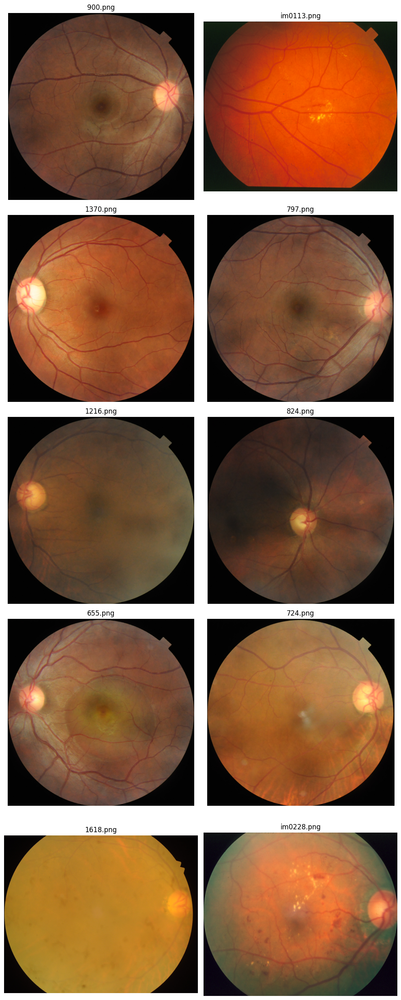

In [ ]:
# Sample Images from Dataset

import matplotlib.pyplot as plt
import os
import random

# Get a list of image files
image_dir = "/content/Multi-Label Retinal Diseases (MuReD) Dataset/images"
image_files = [f for f in os.listdir(image_dir) if os.path.isfile(os.path.join(image_dir, f))]

# Randomly select 10 images
random_images = random.sample(image_files, 10)

# Create a figure with 2 columns
fig, axes = plt.subplots(5, 2, figsize=(10, 25))

# Iterate through the selected images
for i, image_file in enumerate(random_images):
    row = i // 2
    col = i % 2
    image_path = os.path.join(image_dir, image_file)

    # Display each image
    img = plt.imread(image_path)
    axes[row, col].imshow(img)
    axes[row, col].set_title(image_file)
    axes[row, col].axis('off')  # Hide axis

plt.tight_layout()
plt.show()



Training Dataset Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1764 entries, 0 to 1763
Data columns (total 21 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   ID      1764 non-null   object
 1   DR      1764 non-null   int64 
 2   NORMAL  1764 non-null   int64 
 3   MH      1764 non-null   int64 
 4   ODC     1764 non-null   int64 
 5   TSLN    1764 non-null   int64 
 6   ARMD    1764 non-null   int64 
 7   DN      1764 non-null   int64 
 8   MYA     1764 non-null   int64 
 9   BRVO    1764 non-null   int64 
 10  ODP     1764 non-null   int64 
 11  CRVO    1764 non-null   int64 
 12  CNV     1764 non-null   int64 
 13  RS      1764 non-null   int64 
 14  ODE     1764 non-null   int64 
 15  LS      1764 non-null   int64 
 16  CSR     1764 non-null   int64 
 17  HTR     1764 non-null   int64 
 18  ASR     1764 non-null   int64 
 19  CRS     1764 non-null   int64 
 20  OTHER   1764 non-null   int64 
dtypes: int64(20), object(1)
memory usage

<ipython-input-7-63908efabf4d>:43: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=label_counts.index, y=label_counts.values, palette="viridis")


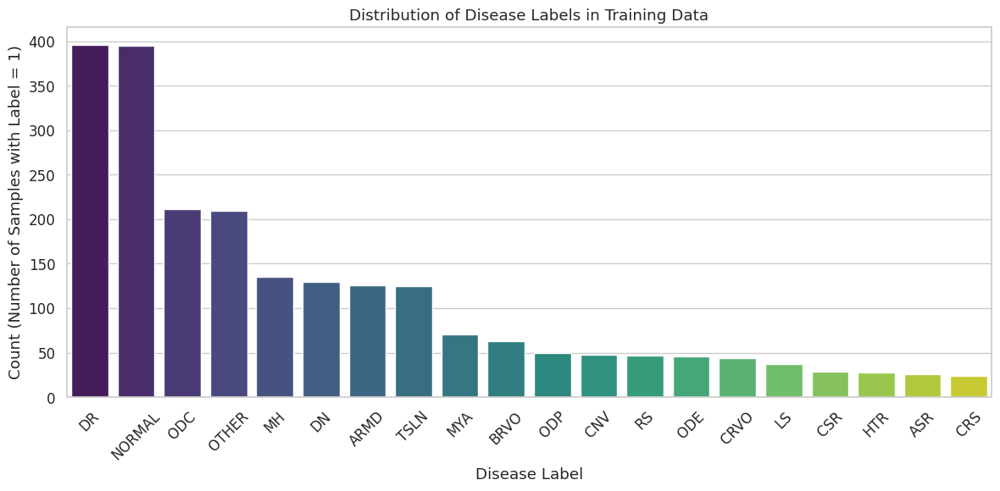

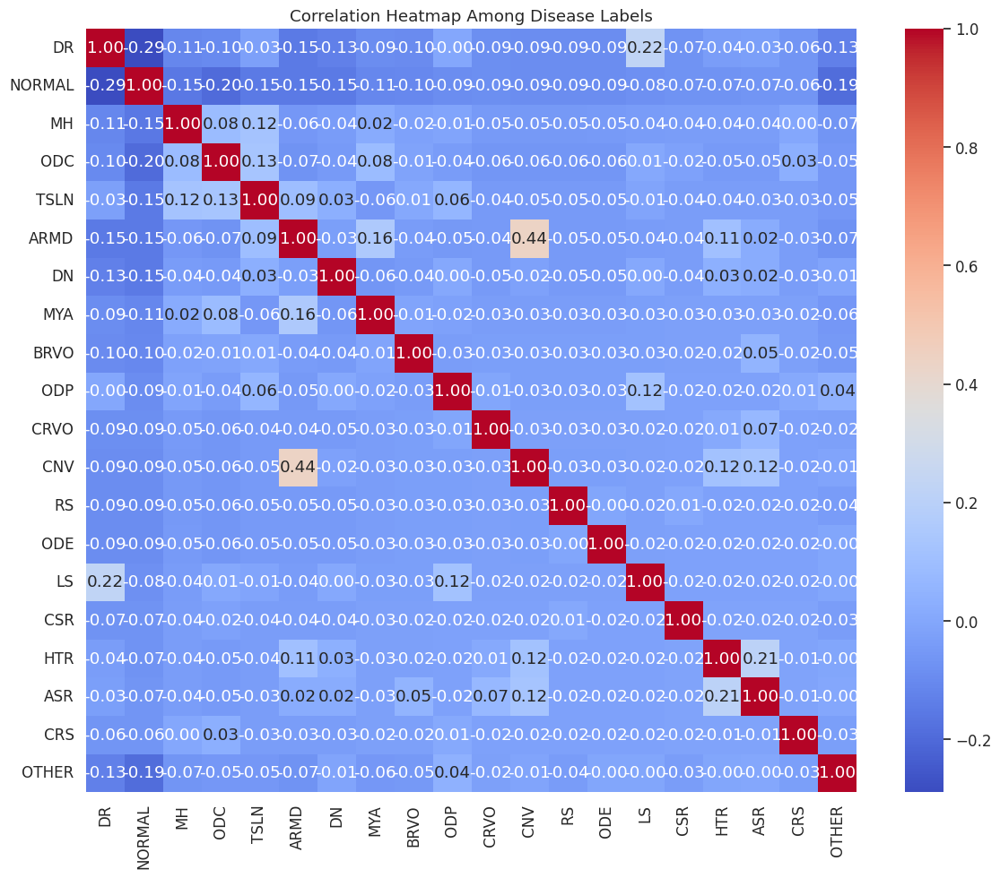

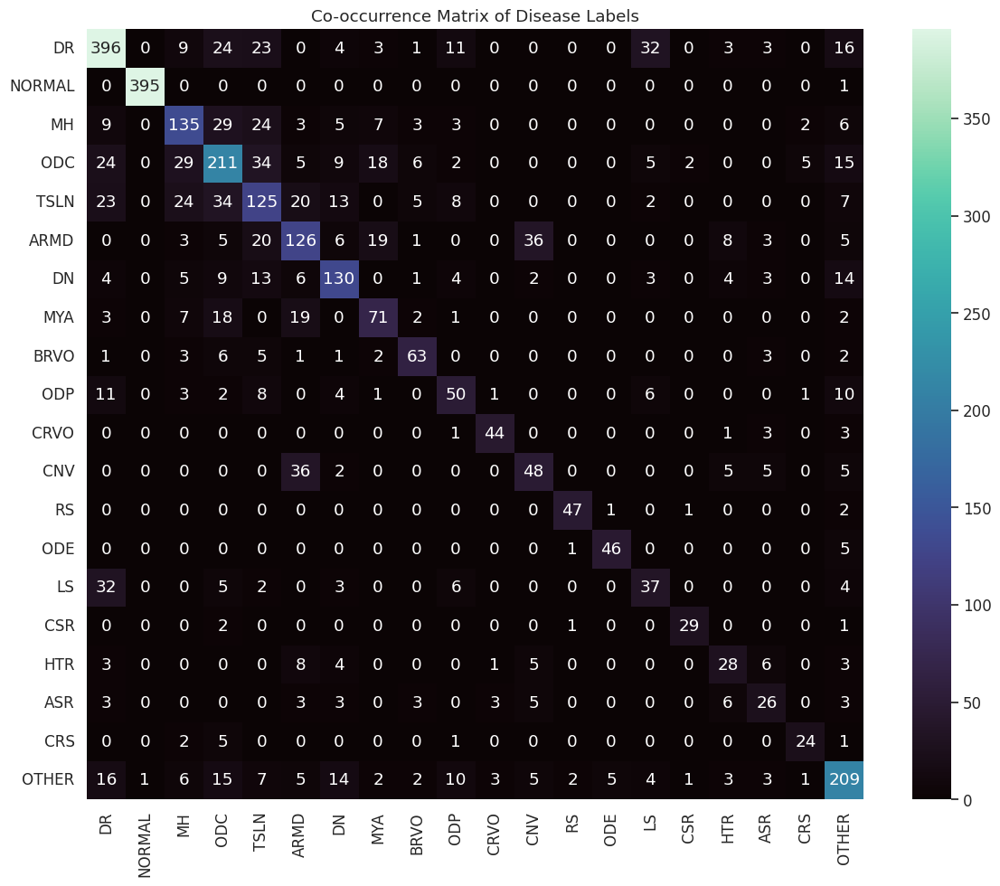

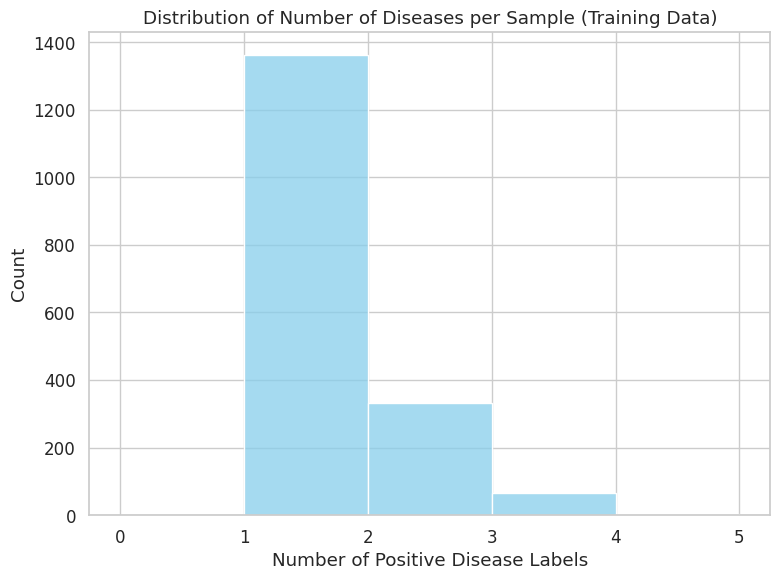

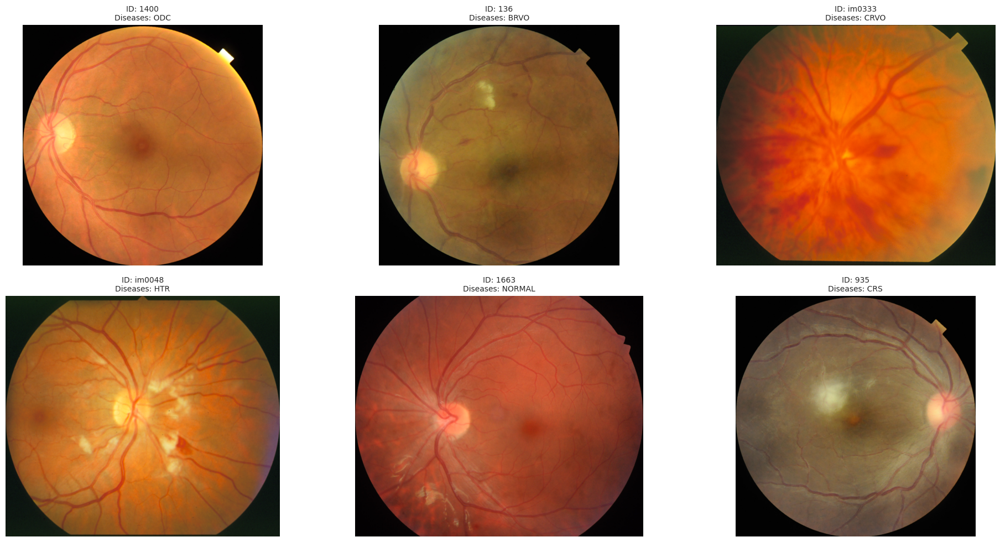

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
from PIL import Image
import random

sns.set(style="whitegrid", font_scale=1.1)


def load_data(train_csv_path: str, val_csv_path: str):
    """
    Load the training and validation CSV files into pandas DataFrames.
    """
    train_df = pd.read_csv(train_csv_path)
    val_df = pd.read_csv(val_csv_path)
    return train_df, val_df


def print_basic_info(df: pd.DataFrame, dataset_name: str = "Dataset"):
    """
    Print basic info and a preview (head) of the DataFrame.
    """
    print(f"\n{dataset_name} Info:")
    print(df.info())
    print(f"\n{dataset_name} Head:")
    print(df.head())


def plot_label_distribution(train_df: pd.DataFrame, disease_columns: list):
    """
    Plot a bar chart showing the distribution (count) of each disease label in the training data.
    """
    # Sum each column (binary labels) to get counts per disease.
    label_counts = train_df[disease_columns].sum().sort_values(ascending=False)

    plt.figure(figsize=(12, 6))
    sns.barplot(x=label_counts.index, y=label_counts.values, palette="viridis")
    plt.xlabel("Disease Label")
    plt.ylabel("Count (Number of Samples with Label = 1)")
    plt.title("Distribution of Disease Labels in Training Data")
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()


def plot_correlation_heatmap(train_df: pd.DataFrame, disease_columns: list):
    """
    Plot a heatmap showing the Pearson correlation between disease labels.
    """
    corr_matrix = train_df[disease_columns].corr()
    plt.figure(figsize=(12, 10))
    sns.heatmap(corr_matrix, annot=True, cmap="coolwarm", fmt=".2f")
    plt.title("Correlation Heatmap Among Disease Labels")
    plt.tight_layout()
    plt.show()


def plot_co_occurrence_matrix(train_df: pd.DataFrame, disease_columns: list):
    """
    Compute and plot a co-occurrence matrix showing how many times each pair of diseases appears together.
    """
    # Co-occurrence: dot product of the label matrix with its transpose.
    co_occurrence = np.dot(train_df[disease_columns].values.T, train_df[disease_columns].values)
    co_occurrence_df = pd.DataFrame(co_occurrence, index=disease_columns, columns=disease_columns)

    plt.figure(figsize=(12, 10))
    sns.heatmap(co_occurrence_df, annot=True, cmap="mako", fmt="d")
    plt.title("Co-occurrence Matrix of Disease Labels")
    plt.tight_layout()
    plt.show()


def plot_num_diseases_distribution(train_df: pd.DataFrame, disease_columns: list):
    """
    Plot the distribution of the number of positive disease labels per sample.
    """
    # Create a new column counting the number of diseases per sample.
    train_df['num_diseases'] = train_df[disease_columns].sum(axis=1)

    plt.figure(figsize=(8, 6))
    sns.histplot(train_df['num_diseases'], bins=range(0, int(train_df['num_diseases'].max()) + 2),
                 kde=False, color="skyblue")
    plt.xlabel("Number of Positive Disease Labels")
    plt.title("Distribution of Number of Diseases per Sample (Training Data)")
    plt.tight_layout()
    plt.show()


def get_image_path(image_id: str, image_folder: str):
    """
    Given an image ID, return the full file path if found. Checks for .png and .tif extensions.
    """
    # First try with .png extension.
    png_path = os.path.join(image_folder, image_id + '.png')
    if os.path.exists(png_path):
        return png_path

    # Then try with .tif extension.
    tif_path = os.path.join(image_folder, image_id + '.tif')
    if os.path.exists(tif_path):
        return tif_path

    # Sometimes the CSV ID might already include the extension.
    candidate = os.path.join(image_folder, image_id)
    if os.path.exists(candidate):
        return candidate

    return None


def display_sample_images(df: pd.DataFrame, disease_columns: list, image_folder: str, num_samples: int = 6):
    """
    Randomly select a few samples from the DataFrame, load the corresponding images,
    and display them with metadata such as image ID and positive disease labels.
    """
    sample_df = df.sample(n=num_samples, random_state=42)
    plt.figure(figsize=(20, 10))

    for i, (_, row) in enumerate(sample_df.iterrows()):
        image_id = row['ID']
        image_path = get_image_path(image_id, image_folder)

        if image_path is None:
            print(f"Image for ID {image_id} not found. Skipping.")
            continue

        try:
            image = Image.open(image_path)
        except Exception as e:
            print(f"Error loading image {image_path}: {e}")
            continue

        # Determine which disease labels are positive (i.e., value = 1)
        positive_labels = [col for col in disease_columns if row[col] == 1]
        title = f"ID: {image_id}\nDiseases: " + (", ".join(positive_labels) if positive_labels else "None")

        plt.subplot(2, (num_samples + 1) // 2, i + 1)
        plt.imshow(image)
        plt.title(title, fontsize=10)
        plt.axis("off")

    plt.tight_layout()
    plt.show()


def main():
    # Define paths to your CSV files and images folder.
    train_csv_path = '/content/Multi-Label Retinal Diseases (MuReD) Dataset/train_data.csv'
    val_csv_path = '/content/Multi-Label Retinal Diseases (MuReD) Dataset/val_data.csv'
    image_folder = '/content/Multi-Label Retinal Diseases (MuReD) Dataset/images'

    # Load the data
    train_df, val_df = load_data(train_csv_path, val_csv_path)

    # Print basic information and preview the data.
    print_basic_info(train_df, "Training Dataset")
    print_basic_info(val_df, "Validation Dataset")

    # Get list of disease columns (all columns except 'ID')
    disease_columns = list(train_df.columns)
    if 'ID' in disease_columns:
        disease_columns.remove('ID')

    # Check for missing values in the training data.
    missing_train = train_df.isnull().sum()
    if missing_train.any():
        print("\nMissing values in training data:")
        print(missing_train[missing_train > 0])
    else:
        print("\nNo missing values found in training data.")

    # Perform various EDA plots.
    plot_label_distribution(train_df, disease_columns)
    plot_correlation_heatmap(train_df, disease_columns)
    plot_co_occurrence_matrix(train_df, disease_columns)
    plot_num_diseases_distribution(train_df, disease_columns)

    # Display a few sample images with their metadata.
    display_sample_images(train_df, disease_columns, image_folder, num_samples=6)


# %% [code]
if __name__ == "__main__":
    main()


# Section 3: Data Pre-Processing and Data Loading

Original sample counts per disease label:
DR        396
NORMAL    395
MH        135
ODC       211
TSLN      125
ARMD      126
DN        130
MYA        71
BRVO       63
ODP        50
CRVO       44
CNV        48
RS         47
ODE        46
LS         37
CSR        29
HTR        28
ASR        26
CRS        24
OTHER     209
dtype: int64

Processing DR: current count 396, need 104 more samples.

Processing NORMAL: current count 395, need 105 more samples.

Processing MH: current count 135, need 365 more samples.

Processing ODC: current count 211, need 289 more samples.

Processing TSLN: current count 125, need 375 more samples.

Processing ARMD: current count 126, need 374 more samples.

Processing DN: current count 130, need 370 more samples.

Processing MYA: current count 71, need 429 more samples.

Processing BRVO: current count 63, need 437 more samples.

Processing ODP: current count 50, need 450 more samples.

Processing CRVO: current count 44, need 456 more samples.

Processing CNV:

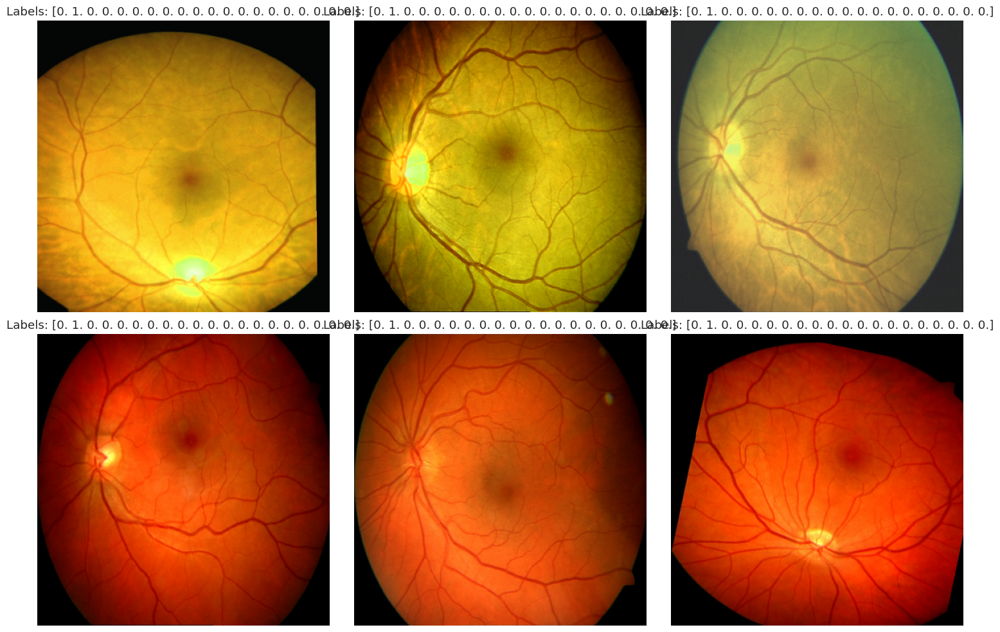

In [ ]:
import os
import cv2
import numpy as np
from PIL import Image
import albumentations as A
from albumentations.pytorch import ToTensorV2
import pandas as pd
import torch
from torch.utils.data import Dataset, DataLoader
import random
import uuid
import matplotlib.pyplot as plt
from concurrent.futures import ThreadPoolExecutor, as_completed

##############################################
# 1. Preprocessing & Augmentation Functions
##############################################

def extract_fov(image: Image.Image) -> Image.Image:
    """
    Extract the Field-of-View (FOV) from a retinal image by cropping out the black borders.
    Converts the image to grayscale, thresholds it, finds the largest contour,
    and then crops the image to the bounding rectangle of that contour.
    """
    image_np = np.array(image)
    gray = cv2.cvtColor(image_np, cv2.COLOR_RGB2GRAY)
    _, mask = cv2.threshold(gray, 10, 255, cv2.THRESH_BINARY)
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if contours:
        largest_contour = max(contours, key=cv2.contourArea)
        x, y, w, h = cv2.boundingRect(largest_contour)
        fov_image = image.crop((x, y, x + w, y + h))
        return fov_image
    else:
        return image

# Helper function for Albumentations (avoid lambda warnings)
def fov_transform(image, **kwargs):
    return np.array(extract_fov(Image.fromarray(image)))

# Augmentation Pipeline for Training (for saving augmented images; no normalization)
aug_transforms = A.Compose([
    A.Lambda(image=fov_transform),
    A.Resize(384, 384),
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.5),
    A.RandomRotate90(p=0.5),
    A.Affine(rotate=(-15, 15), scale=(0.9, 1.1), translate_percent=(-0.0625, 0.0625), p=0.5),
    A.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.2, p=0.5)
    # No normalization here so saved images remain in [0,255]
])

# Transform Pipeline for Training (for model training; includes normalization)
train_transforms = A.Compose([
    A.Lambda(image=fov_transform),
    A.Resize(384, 384),
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.5),
    A.RandomRotate90(p=0.5),
    A.Affine(rotate=(-15, 15), scale=(0.9, 1.1), translate_percent=(-0.0625, 0.0625), p=0.5),
    A.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.2, p=0.5),
    A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
    ToTensorV2()
])

# Transform Pipeline for Validation
val_transforms = A.Compose([
    A.Lambda(image=fov_transform),
    A.Resize(384, 384),
    A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
    ToTensorV2()
])

##############################################
# 2. Oversampling & CSV Update with Multithreading
##############################################

# Parameters & Paths
train_csv_path = '/content/Multi-Label Retinal Diseases (MuReD) Dataset/train_data.csv'
val_csv = '/content/Multi-Label Retinal Diseases (MuReD) Dataset/val_data.csv'
image_folder = '/content/Multi-Label Retinal Diseases (MuReD) Dataset/images'
augmented_folder = '/content/Multi-Label Retinal Diseases (MuReD) Dataset/augmented_images'
new_csv_path = '/content/Multi-Label Retinal Diseases (MuReD) Dataset/train_data_augmented.csv'
target_per_class = 500

# Create folder for augmented images if it doesn't exist
os.makedirs(augmented_folder, exist_ok=True)

# Load Original CSV
df = pd.read_csv(train_csv_path)
disease_columns = list(df.columns)
if 'ID' in disease_columns:
    disease_columns.remove('ID')

print("Original sample counts per disease label:")
print(df[disease_columns].sum())

# Function to augment one sample (to be run in parallel)
def augment_sample(sample, image_folder, augmented_folder):
    original_id = sample['ID']
    # Build image path: try .png then .tif
    img_path = None
    for ext in ['.png', '.tif']:
        candidate = os.path.join(image_folder, original_id + ext)
        if os.path.exists(candidate):
            img_path = candidate
            break
    if img_path is None:
        print(f"Warning: Image for ID {original_id} not found. Skipping sample.")
        return None

    try:
        image = Image.open(img_path).convert("RGB")
        image_np = np.array(image)
        augmented = aug_transforms(image=image_np)
        aug_image = augmented['image']
        # Convert to PIL Image for saving
        aug_image = Image.fromarray(np.uint8(np.clip(aug_image, 0, 255)))
    except Exception as e:
        print(f"Error processing image {original_id}: {e}")
        return None

    new_id = original_id + "_aug_" + str(uuid.uuid4())[:8]
    new_filename = new_id + ".png"
    new_image_path = os.path.join(augmented_folder, new_filename)
    try:
        aug_image.save(new_image_path)
    except Exception as e:
        print(f"Error saving augmented image for {original_id}: {e}")
        return None

    new_row = sample.copy()
    new_row['ID'] = new_id
    return new_row

# List to collect augmented rows
augmented_rows = []

# Use ThreadPoolExecutor for multi-threading
from concurrent.futures import ThreadPoolExecutor, as_completed
max_workers = os.cpu_count() or 4

with ThreadPoolExecutor(max_workers=max_workers) as executor:
    futures = []
    # For each disease label, if current count < target, oversample that class
    for disease in disease_columns:
        current_count = int(df[disease].sum())
        deficit = target_per_class - current_count
        print(f"\nProcessing {disease}: current count {current_count}, need {deficit} more samples.")

        if deficit <= 0:
            print(f"  Skipping {disease} since target reached.")
            continue

        pos_samples = df[df[disease] == 1]
        if pos_samples.empty:
            print(f"  No positive samples for {disease}; skipping.")
            continue

        for i in range(deficit):
            sample = pos_samples.sample(n=1, random_state=random.randint(0, 10000)).iloc[0].to_dict()
            futures.append(executor.submit(augment_sample, sample, image_folder, augmented_folder))

    for future in as_completed(futures):
        result = future.result()
        if result is not None:
            augmented_rows.append(result)

# Combine original and augmented samples into a new DataFrame
if augmented_rows:
    aug_df = pd.DataFrame(augmented_rows)
    new_df = pd.concat([df, aug_df], ignore_index=True)
else:
    new_df = df.copy()

print("\nNew sample counts per disease label after augmentation:")
print(new_df[disease_columns].sum())

# Save the new CSV with augmented samples
new_df.to_csv(new_csv_path, index=False)
print(f"\nNew CSV with augmented samples saved to: {new_csv_path}")

##############################################
# 3. Custom Dataset & DataLoader Creation
##############################################

class RetinalDataset(Dataset):
    def __init__(self, csv_file: str, image_folder: str, transforms=None):
        """
        Args:
            csv_file (str): Path to the CSV file with annotations.
            image_folder (str): Directory with images.
            transforms: Albumentations transforms to apply.
        """
        self.data = pd.read_csv(csv_file)
        self.image_folder = image_folder
        self.transforms = transforms
        self.labels = self.data.drop('ID', axis=1).values.astype(np.float32)
        self.image_ids = self.data['ID'].tolist()

    def __len__(self):
        return len(self.data)

    def get_image_path(self, image_id: str) -> str:
        for ext in ['.png', '.tif']:
            path = os.path.join(self.image_folder, image_id + ext)
            if os.path.exists(path):
                return path
        candidate = os.path.join(self.image_folder, image_id)
        if os.path.exists(candidate):
            return candidate
        return None

    def __getitem__(self, idx):
        image_id = self.image_ids[idx]
        image_path = self.get_image_path(image_id)
        if image_path is None:
            raise FileNotFoundError(f"Image for ID {image_id} not found.")
        image = Image.open(image_path).convert("RGB")
        image_np = np.array(image)
        if self.transforms:
            augmented = self.transforms(image=image_np)
            image_tensor = augmented['image']
        else:
            image_tensor = torch.tensor(image_np).permute(2, 0, 1).float() / 255.0
        label = torch.tensor(self.labels[idx])
        return image_tensor, label

class CombinedRetinalDataset(Dataset):
    def __init__(self, csv_file: str, original_folder: str, augmented_folder: str, transforms=None):
        self.data = pd.read_csv(csv_file)
        self.original_folder = original_folder
        self.augmented_folder = augmented_folder
        self.transforms = transforms
        self.labels = self.data.drop('ID', axis=1).values.astype(np.float32)
        self.image_ids = self.data['ID'].tolist()

    def __len__(self):
        return len(self.data)

    def get_image_path(self, image_id: str) -> str:
        # First check the augmented folder
        for ext in ['.png', '.tif']:
            path = os.path.join(self.augmented_folder, image_id + ext)
            if os.path.exists(path):
                return path
        # Then check the original folder
        for ext in ['.png', '.tif']:
            path = os.path.join(self.original_folder, image_id + ext)
            if os.path.exists(path):
                return path
        candidate = os.path.join(self.original_folder, image_id)
        if os.path.exists(candidate):
            return candidate
        return None

    def __getitem__(self, idx):
        image_id = self.image_ids[idx]
        image_path = self.get_image_path(image_id)
        if image_path is None:
            raise FileNotFoundError(f"Image for ID {image_id} not found.")
        image = Image.open(image_path).convert("RGB")
        image_np = np.array(image)
        if self.transforms:
            augmented = self.transforms(image=image_np)
            image_tensor = augmented['image']
        else:
            image_tensor = torch.tensor(image_np).permute(2, 0, 1).float() / 255.0
        label = torch.tensor(self.labels[idx])
        return image_tensor, label

# Create dataset instances using the new CSV
combined_dataset = CombinedRetinalDataset(new_csv_path, original_folder=image_folder,
                                            augmented_folder=augmented_folder,
                                            transforms=train_transforms)
val_dataset = RetinalDataset(val_csv, image_folder, transforms=val_transforms)

# Create DataLoaders
train_loader = DataLoader(combined_dataset, batch_size=32, shuffle=True, num_workers=4)
val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False, num_workers=4)

##############################################
# 4. Visualize a Few Samples from the Updated Training Set
##############################################
def denormalize(image_tensor, mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)):
    image = image_tensor.clone().detach()
    for t, m, s in zip(image, mean, std):
        t.mul_(s).add_(m)
    return image.clamp(0, 1)

def show_samples(dataset, num_samples=6):
    plt.figure(figsize=(15, 10))
    for i in range(num_samples):
        image_tensor, label = dataset[i]
        image_tensor = denormalize(image_tensor)
        image = image_tensor.permute(1, 2, 0).cpu().numpy()
        plt.subplot(2, (num_samples + 1) // 2, i + 1)
        plt.imshow(image)
        plt.title(f"Labels: {label.numpy()}")
        plt.axis("off")
    plt.tight_layout()
    plt.show()

show_samples(combined_dataset, num_samples=6)



Disease: DR | Number of samples: 1300


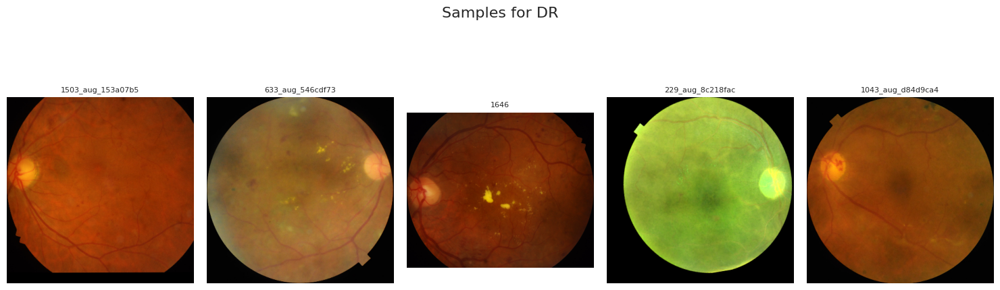


Disease: NORMAL | Number of samples: 502


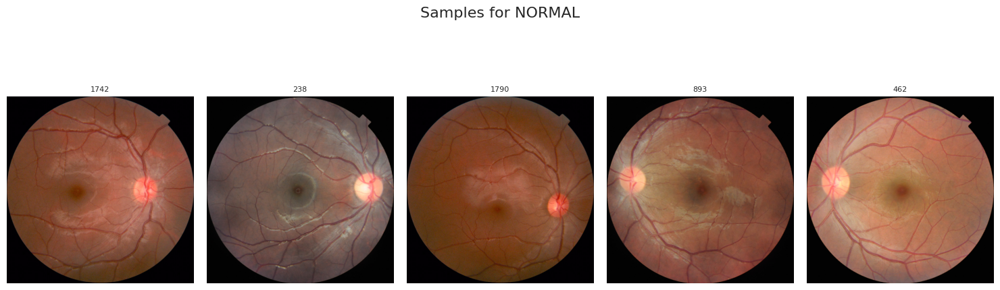


Disease: MH | Number of samples: 796


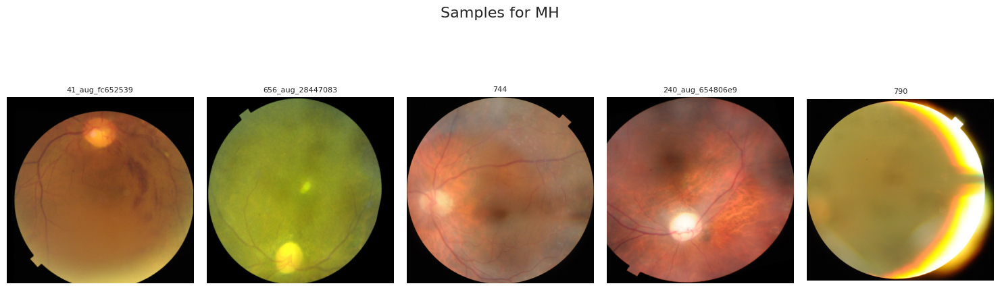


Disease: ODC | Number of samples: 1103


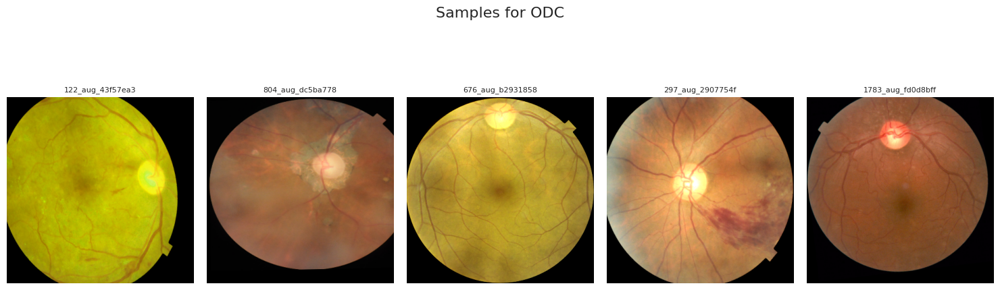


Disease: TSLN | Number of samples: 875


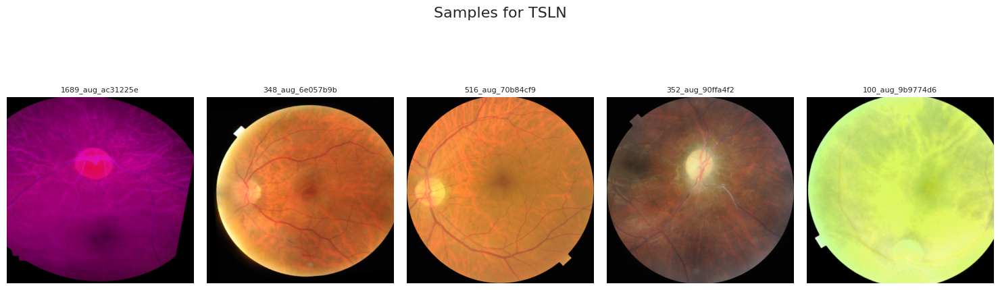


Disease: ARMD | Number of samples: 1268


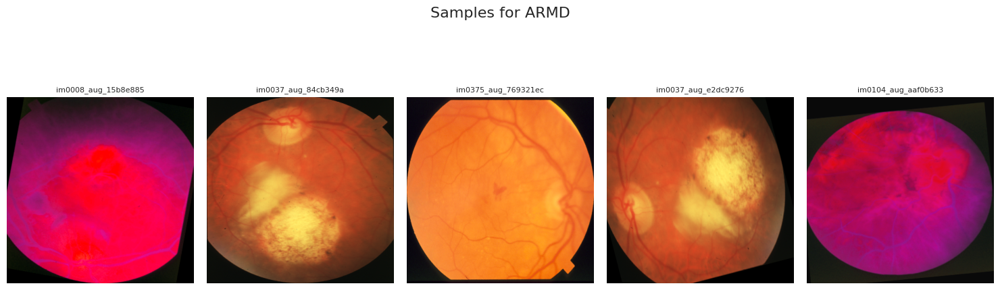


Disease: DN | Number of samples: 825


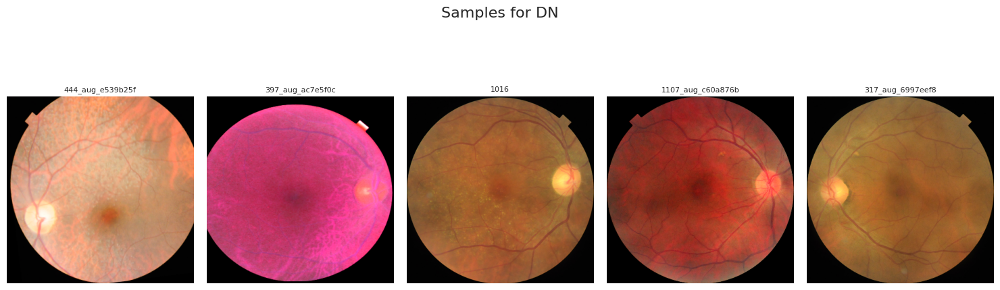


Disease: MYA | Number of samples: 619


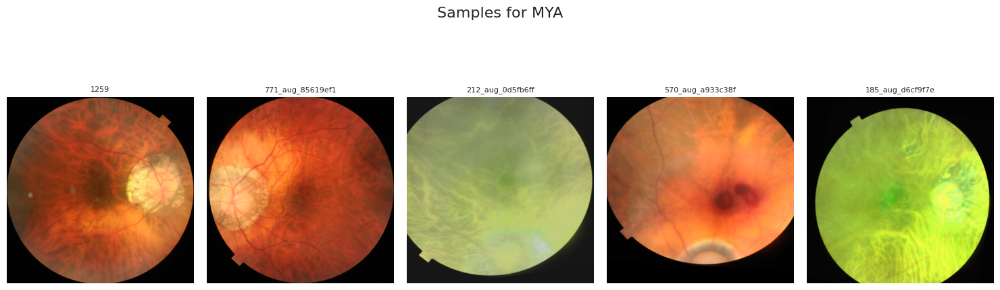


Disease: BRVO | Number of samples: 594


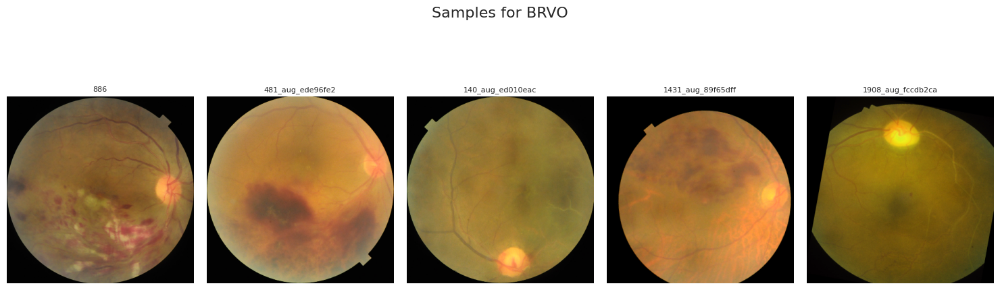


Disease: ODP | Number of samples: 666


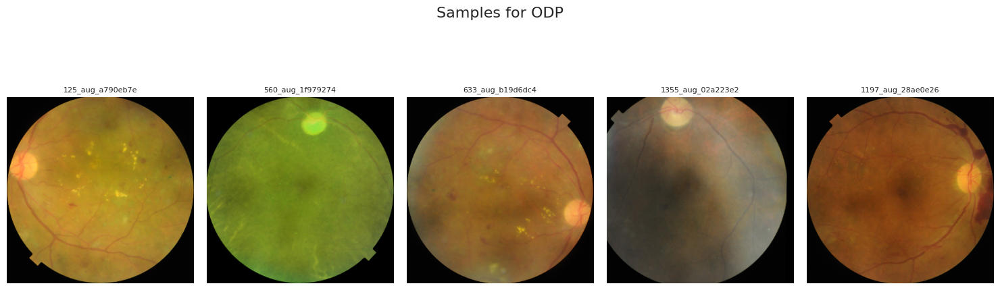


Disease: CRVO | Number of samples: 581


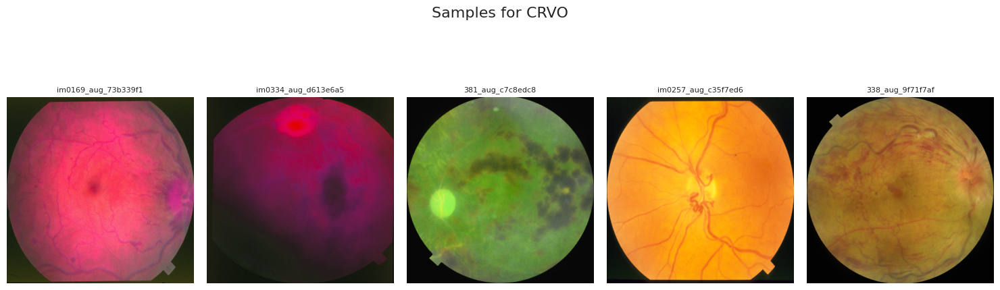


Disease: CNV | Number of samples: 776


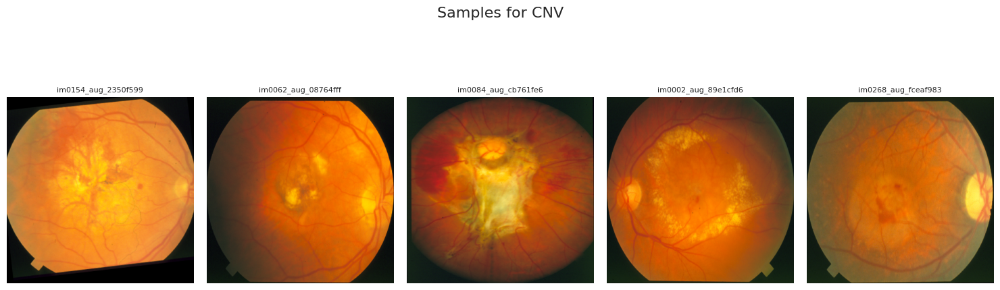


Disease: RS | Number of samples: 523


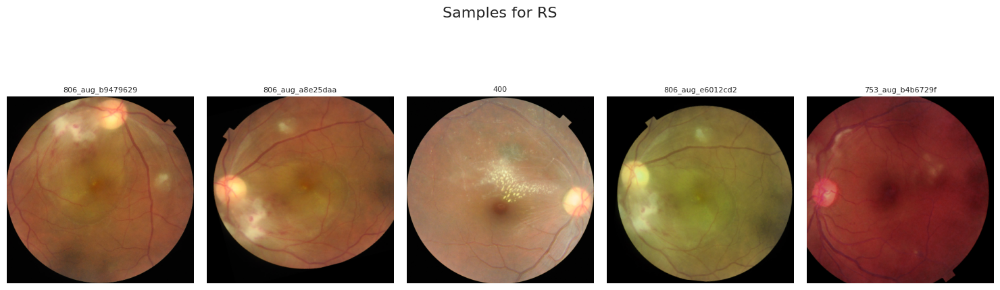


Disease: ODE | Number of samples: 520


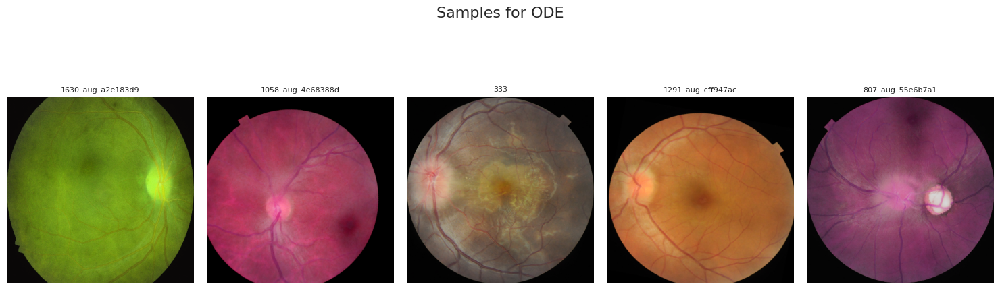


Disease: LS | Number of samples: 583


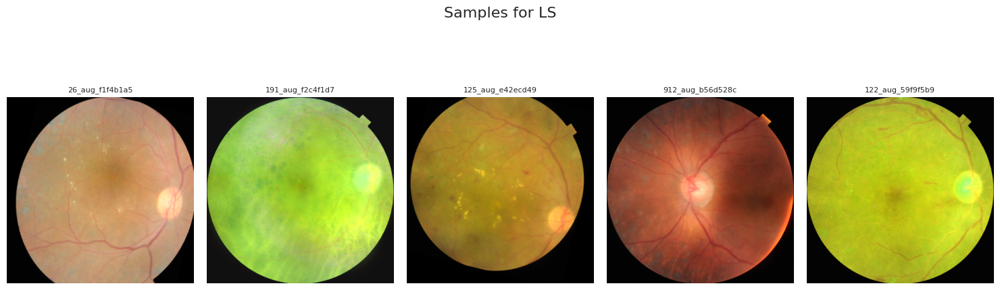


Disease: CSR | Number of samples: 515


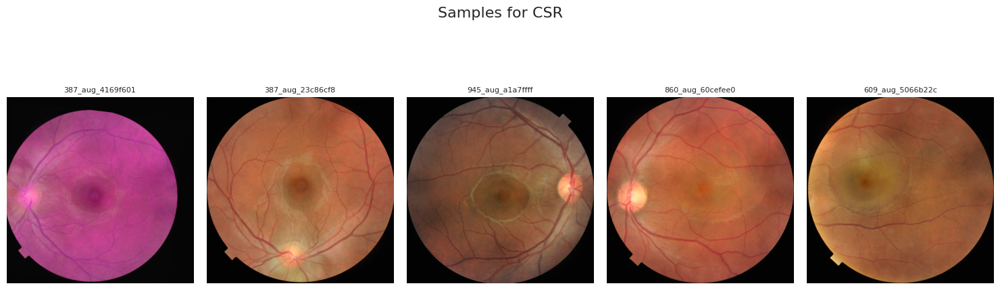


Disease: HTR | Number of samples: 703


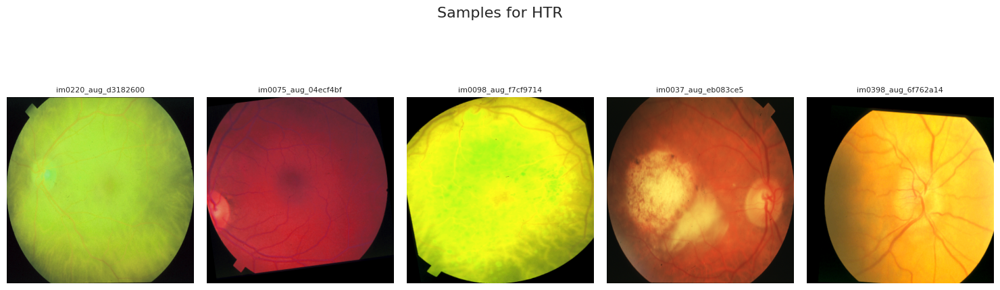


Disease: ASR | Number of samples: 704


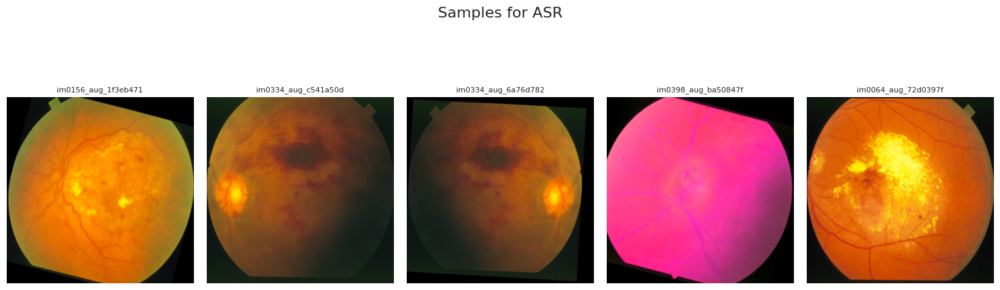


Disease: CRS | Number of samples: 522


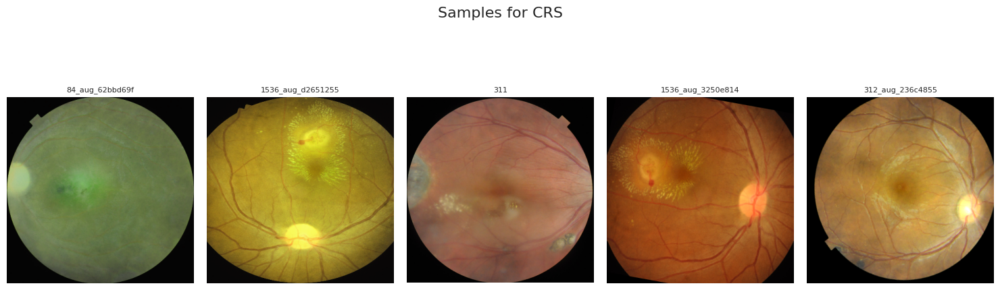


Disease: OTHER | Number of samples: 1058


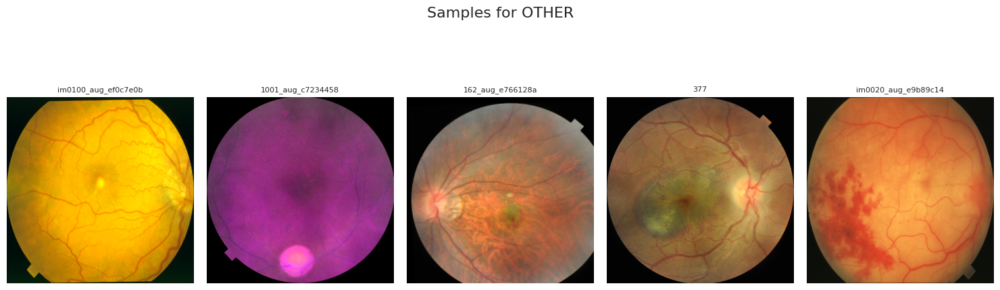

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd
import os
from PIL import Image
import random

def display_images_per_class(df: pd.DataFrame, original_folder: str, augmented_folder: str, disease_columns: list, samples_per_class: int = 5):
    """
    For each disease label, randomly select a few samples where the disease is positive and display them.
    It first checks for the image in the augmented folder; if not found, it falls back to the original folder.
    """
    for disease in disease_columns:
        # Filter samples where the disease label is positive (1)
        disease_df = df[df[disease] == 1]
        count = len(disease_df)
        print(f"\nDisease: {disease} | Number of samples: {count}")
        if count == 0:
            print("  No samples available for this disease.")
            continue

        # Randomly select some sample image IDs (if there are fewer than desired, use all)
        sample_ids = disease_df['ID'].sample(n=min(samples_per_class, count), random_state=42).tolist()

        # Set up plot grid
        fig, axes = plt.subplots(1, min(samples_per_class, count), figsize=(15, 5))
        if min(samples_per_class, count) == 1:
            axes = [axes]  # ensure axes is iterable

        for ax, image_id in zip(axes, sample_ids):
            image_path = None
            # First, try augmented folder
            for ext in ['.png', '.tif']:
                candidate = os.path.join(augmented_folder, image_id + ext)
                if os.path.exists(candidate):
                    image_path = candidate
                    break
            # If not found, try original folder
            if image_path is None:
                for ext in ['.png', '.tif']:
                    candidate = os.path.join(original_folder, image_id + ext)
                    if os.path.exists(candidate):
                        image_path = candidate
                        break

            if image_path is not None:
                image = Image.open(image_path).convert("RGB")
                ax.imshow(image)
                ax.set_title(image_id, fontsize=8)
            else:
                ax.text(0.5, 0.5, "Image not found", horizontalalignment='center', verticalalignment='center')
            ax.axis("off")
        plt.suptitle(f"Samples for {disease}", fontsize=16)
        plt.tight_layout(rect=[0, 0, 1, 0.95])
        plt.show()

# Update paths for training CSV and image directories
new_train_csv_path = '/content/Multi-Label Retinal Diseases (MuReD) Dataset/train_data_augmented.csv'
original_folder = '/content/Multi-Label Retinal Diseases (MuReD) Dataset/images'
augmented_folder = '/content/Multi-Label Retinal Diseases (MuReD) Dataset/augmented_images'

# Load the updated training DataFrame
train_df = pd.read_csv(new_train_csv_path)
disease_columns = list(train_df.columns)
if 'ID' in disease_columns:
    disease_columns.remove('ID')

# Display images per disease class using the updated CSV and image folders
display_images_per_class(train_df, original_folder, augmented_folder, disease_columns, samples_per_class=5)


# Section 4: Models Training and Evaluation

In [ ]:
# check if we have cuda gpu

import torch
if torch.cuda.is_available():
  print("CUDA GPU is available.")
else:
  print("CUDA GPU is not available.")

CUDA GPU is available.


In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
import torchvision.models as models
import timm  
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score
import time
import threading
from concurrent.futures import ThreadPoolExecutor, as_completed

# ------------------------------
# Custom DeepCNN
# ------------------------------
class CustomDeepCNN(nn.Module):
    def __init__(self, num_classes):
        super(CustomDeepCNN, self).__init__()
        self.features = nn.Sequential(
            nn.Conv2d(3, 32, kernel_size=3, stride=1, padding=1),  # [B,32,384,384]
            nn.ReLU(),
            nn.MaxPool2d(2),  # [B,32,192,192]
            nn.Conv2d(32, 64, kernel_size=3, padding=1),  # [B,64,192,192]
            nn.ReLU(),
            nn.MaxPool2d(2),  # [B,64,96,96]
            nn.Conv2d(64, 128, kernel_size=3, padding=1),  # [B,128,96,96]
            nn.ReLU(),
            nn.MaxPool2d(2),  # [B,128,48,48]
            nn.Conv2d(128, 256, kernel_size=3, padding=1),  # [B,256,48,48]
            nn.ReLU(),
            nn.MaxPool2d(2),  # [B,256,24,24]
        )
        self.classifier = nn.Sequential(
            nn.AdaptiveAvgPool2d(1),  # [B,256,1,1]
            nn.Flatten(),
            nn.Linear(256, 128),
            nn.ReLU(),
            nn.Linear(128, num_classes),
            nn.Sigmoid()  
        )

    def forward(self, x):
        x = self.features(x)
        x = self.classifier(x)
        return x

# ------------------------------
# Model Builder Function
# ------------------------------
def get_model(model_name, num_classes):
    if model_name == 'CustomDeepCNN':
        model = CustomDeepCNN(num_classes)
    elif model_name == 'VGG16':
        model = models.vgg16(pretrained=True)
        model.classifier[-1] = nn.Linear(model.classifier[-1].in_features, num_classes)
        model.classifier.add_module('sigmoid', nn.Sigmoid())
    elif model_name == 'VGG19':
        model = models.vgg19(pretrained=True)
        model.classifier[-1] = nn.Linear(model.classifier[-1].in_features, num_classes)
        model.classifier.add_module('sigmoid', nn.Sigmoid())
    elif model_name == 'EfficientNetB7':
        model = timm.create_model('tf_efficientnet_b7_ns', pretrained=True)
        model.classifier = nn.Linear(model.classifier.in_features, num_classes)
        model.add_module('sigmoid', nn.Sigmoid())
    elif model_name == 'DenseNet169':
        model = models.densenet169(pretrained=True)
        model.classifier = nn.Linear(model.classifier.in_features, num_classes)
        model.classifier = nn.Sequential(model.classifier, nn.Sigmoid())
    elif model_name == 'MobileNet':
        model = timm.create_model('mobilenetv3_large_100', pretrained=True)
        model.classifier = nn.Linear(model.classifier.in_features, num_classes)
        model.add_module('sigmoid', nn.Sigmoid())
    elif model_name == 'VisionTransformer':
        model = timm.create_model('vit_base_patch16_384', pretrained=True)
        model.head = nn.Linear(model.head.in_features, num_classes)
        model.add_module('sigmoid', nn.Sigmoid())
    else:
        raise ValueError("Unknown model name")
    return model

# ------------------------------
# Training & Evaluation Functions
# ------------------------------
def train_one_epoch(model, dataloader, criterion, optimizer, device):
    model.train()
    running_loss = 0.0
    for images, labels in dataloader:
        images = images.to(device)
        labels = labels.to(device)
        optimizer.zero_grad()
        outputs = model(images)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        running_loss += loss.item() * images.size(0)
    epoch_loss = running_loss / len(dataloader.dataset)
    return epoch_loss

def evaluate_model(model, dataloader, device):
    model.eval()
    all_labels = []
    all_preds = []
    with torch.no_grad():
        for images, labels in dataloader:
            images = images.to(device)
            outputs = model(images)
            preds = outputs.cpu().numpy()
            all_preds.append(preds)
            all_labels.append(labels.numpy())
    all_preds = np.vstack(all_preds)
    all_labels = np.vstack(all_labels)
    bin_preds = (all_preds > 0.5).astype(int)
    acc = accuracy_score(all_labels, bin_preds)
    prec = precision_score(all_labels, bin_preds, average='macro', zero_division=0)
    rec = recall_score(all_labels, bin_preds, average='macro', zero_division=0)
    f1 = f1_score(all_labels, bin_preds, average='macro', zero_division=0)
    try:
        roc_auc = roc_auc_score(all_labels, all_preds, average='macro')
    except Exception as e:
        roc_auc = np.nan
        print("ROC AUC calculation error:", e)
    return acc, prec, rec, f1, roc_auc

def train_and_evaluate(model, train_loader, val_loader, device, epochs=10, lr=1e-5, gpu_lock=None):
    criterion = nn.BCELoss()
    optimizer = optim.Adam(model.parameters(), lr=lr)
    best_val_acc = 0.0
    history = {'train_loss': [], 'val_acc': [], 'val_prec': [], 'val_rec': [], 'val_f1': [], 'val_auc': []}

    for epoch in range(epochs):
        start_time = time.time()
        if gpu_lock:
            with gpu_lock:  # Ensure only one model uses the GPU at a time
                train_loss = train_one_epoch(model, train_loader, criterion, optimizer, device)
                acc, prec, rec, f1, roc_auc = evaluate_model(model, val_loader, device)
        else:
            train_loss = train_one_epoch(model, train_loader, criterion, optimizer, device)
            acc, prec, rec, f1, roc_auc = evaluate_model(model, val_loader, device)
        epoch_time = time.time() - start_time
        history['train_loss'].append(train_loss)
        history['val_acc'].append(acc)
        history['val_prec'].append(prec)
        history['val_rec'].append(rec)
        history['val_f1'].append(f1)
        history['val_auc'].append(roc_auc)
        print(f"Epoch [{epoch+1}/{epochs}] | Loss: {train_loss:.4f} | Acc: {acc:.4f} | Prec: {prec:.4f} | Rec: {rec:.4f} | F1: {f1:.4f} | AUC: {roc_auc:.4f} | Time: {epoch_time:.2f}s")
        if acc > best_val_acc:
            best_val_acc = acc
    return history

# ------------------------------
# Parallel Training Setup
# ------------------------------

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# Load the updated CSV and get disease columns
train_csv_path = '/content/Multi-Label Retinal Diseases (MuReD) Dataset/train_data_augmented.csv'
df = pd.read_csv(train_csv_path)
disease_columns = list(df.columns)
if 'ID' in disease_columns:
    disease_columns.remove('ID')
num_classes = len(disease_columns)


# Global GPU lock to ensure only one thread accesses GPU at a time.
gpu_lock = threading.Lock()

model_names = ['CustomDeepCNN', 'VGG16', 'VGG19', 'EfficientNetB7', 'DenseNet169', 'MobileNet', 'VisionTransformer']
model_histories = {}
model_metrics = {}

# Function to train one model (to be run in parallel)
def train_model_parallel(model_name):
    print(f"\n==== Training Model: {model_name} ====")
    model = get_model(model_name, num_classes)
    model = model.to(device)
    history = train_and_evaluate(model, train_loader, val_loader, device, epochs=10, lr=1e-5, gpu_lock=gpu_lock)
    acc, prec, rec, f1, auc = evaluate_model(model, val_loader, device)
    result = (model_name, history, {'Acc': acc, 'Prec': prec, 'Rec': rec, 'F1': f1, 'AUC': auc}, model.state_dict())
    # Free up GPU memory for this model
    del model
    torch.cuda.empty_cache()
    return result

# Use ThreadPoolExecutor to run training in parallel.
results = {}
with ThreadPoolExecutor(max_workers=len(model_names)) as executor:
    futures = {executor.submit(train_model_parallel, name): name for name in model_names}
    for future in as_completed(futures):
        model_name, history, metrics, state_dict = future.result()
        model_histories[model_name] = history
        model_metrics[model_name] = metrics
        results[model_name] = state_dict





==== Training Model: CustomDeepCNN ====

==== Training Model: VGG16 ====

==== Training Model: VGG19 ====

==== Training Model: EfficientNetB7 ====

==== Training Model: DenseNet169 ====

==== Training Model: MobileNet ====

==== Training Model: VisionTransformer ====


/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet169_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet169_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
/usr/local/lib/python3.11/dist-packages/timm/models/_factory.py:126: UserWarning: Mapping deprecated model name tf_efficientnet_b7_ns to current tf_efficientnet_b7.ns_jft_in1k.
  model = create_

model.safetensors:   0%|          | 0.00/22.1M [00:00<?, ?B/s]


 53%|█████▎    | 292M/548M [00:02<00:02, 114MB/s]

model.safetensors:   0%|          | 0.00/347M [00:00<?, ?B/s]

 67%|██████▋   | 351M/528M [00:02<00:01, 97.0MB/s]
 55%|█████▌    | 303M/548M [00:02<00:02, 88.1MB/s]
 68%|██████▊   | 361M/528M [00:02<00:01, 95.3MB/s]
 71%|███████   | 373M/528M [00:02<00:01, 102MB/s] 
 73%|███████▎  | 386M/528M [00:02<00:01, 109MB/s]
 76%|███████▌  | 398M/528M [00:02<00:01, 115MB/s]
 78%|███████▊  | 412M/528M [00:03<00:00, 122MB/s]
 81%|████████  | 427M/528M [00:03<00:00, 133MB/s]Downloading: "https://download.pytorch.org/models/densenet169-b2777c0a.pth" to /root/.cache/torch/hub/checkpoints/densenet169-b2777c0a.pth

 72%|███████▏  | 397M/548M [00:03<00:01, 143MB/s]

 84%|████████▍ | 442M/528M [00:03<00:00, 140MB/s]

 16%|█▌        | 8.62M/54.7M [00:00<00:00, 90.3MB/s]
 87%|████████▋ | 457M/528M [00:03<00:00, 144MB/s]

 45%|████▍     | 24.4M/54.7M [00:00<00:00, 134MB/s] 
 89%|████████▉ | 471M/528M [00:03<00:00, 141MB/s]
 92%|█████████▏| 486M/528M [00:03<00:00, 144MB/s]

 68%|██████▊   | 37.1M/54.7M [00:00<00:00, 121MB/s]
 95%|█████████▌| 502M/528M [00:03<00:00, 154M

model.safetensors:   0%|          | 0.00/267M [00:00<?, ?B/s]


 91%|█████████ | 498M/548M [00:04<00:00, 64.9MB/s]
 94%|█████████▎| 513M/548M [00:04<00:00, 79.0MB/s]
 96%|█████████▌| 527M/548M [00:04<00:00, 92.8MB/s]
100%|██████████| 548M/548M [00:04<00:00, 120MB/s] 


In [ ]:
from sklearn.metrics import classification_report

# Plot training loss and accuracy over epochs
def plot_loss_accuracy_curves(model_histories):
    for model_name, history in model_histories.items():
        epochs = range(1, len(history['train_loss']) + 1)
        plt.figure(figsize=(12, 5))

        # Plot Loss
        plt.subplot(1, 2, 1)
        plt.plot(epochs, history['train_loss'], label='Train Loss')
        plt.title(f'{model_name} - Loss Curve')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.grid(True)
        plt.legend()

        # Plot Accuracy
        plt.subplot(1, 2, 2)
        plt.plot(epochs, history['val_acc'], label='Validation Accuracy', color='orange')
        plt.title(f'{model_name} - Accuracy Curve')
        plt.xlabel('Epoch')
        plt.ylabel('Accuracy')
        plt.grid(True)
        plt.legend()

        plt.tight_layout()
        plt.show()


# Generate classification report
def print_classification_reports(results, val_loader, device, disease_columns):
    for model_name, state_dict in results.items():
        print(f"\n====== Classification Report: {model_name} ======")
        model = get_model(model_name, len(disease_columns))
        model.load_state_dict(state_dict)
        model.to(device)
        model.eval()

        all_labels = []
        all_preds = []
        with torch.no_grad():
            for images, labels in val_loader:
                images = images.to(device)
                outputs = model(images)
                preds = (outputs.cpu().numpy() > 0.5).astype(int)
                all_preds.append(preds)
                all_labels.append(labels.numpy())

        all_preds = np.vstack(all_preds)
        all_labels = np.vstack(all_labels)

        # Print one-vs-rest classification report for multilabel
        print(classification_report(all_labels, all_preds, target_names=disease_columns, zero_division=0))

        del model
        torch.cuda.empty_cache()


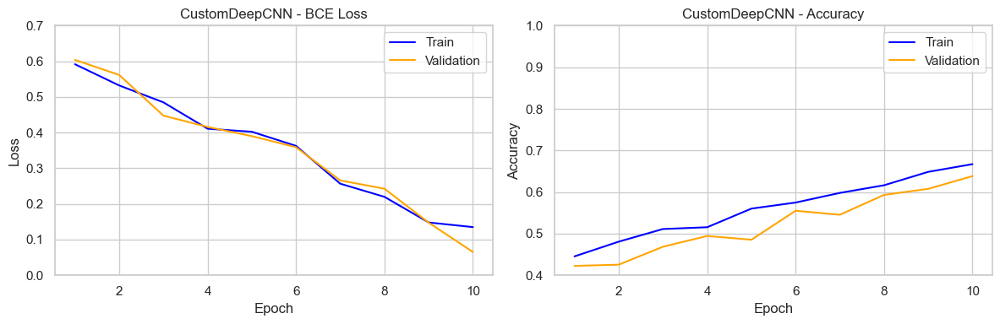

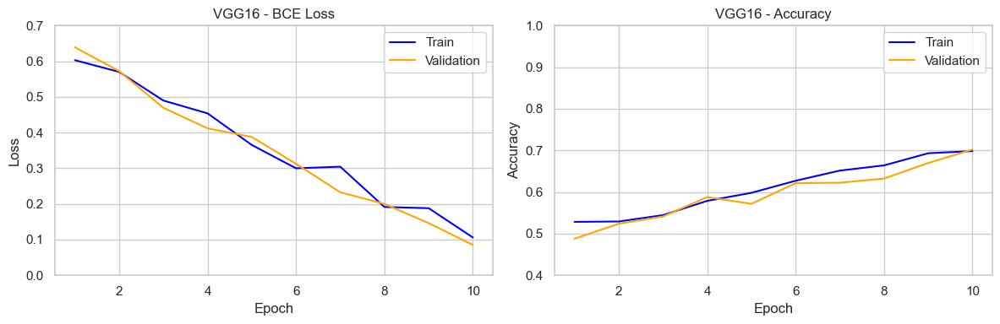

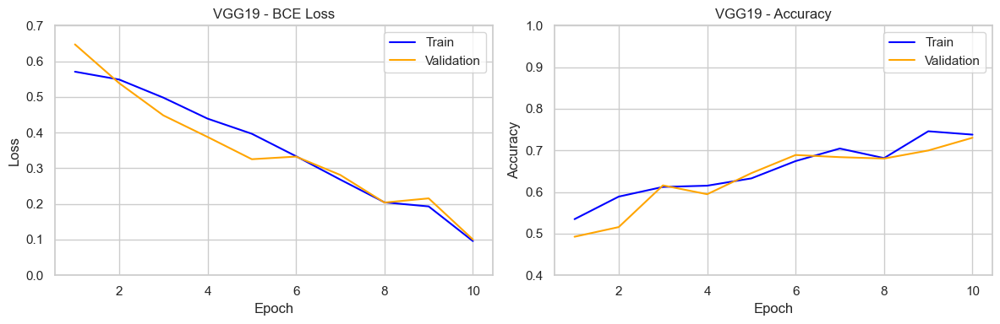

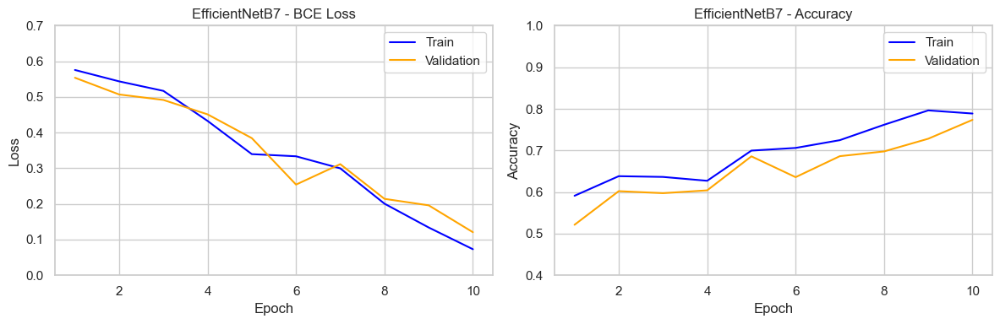

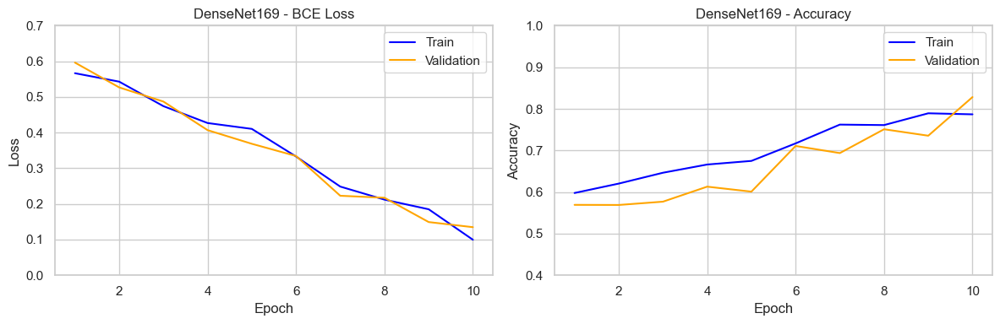

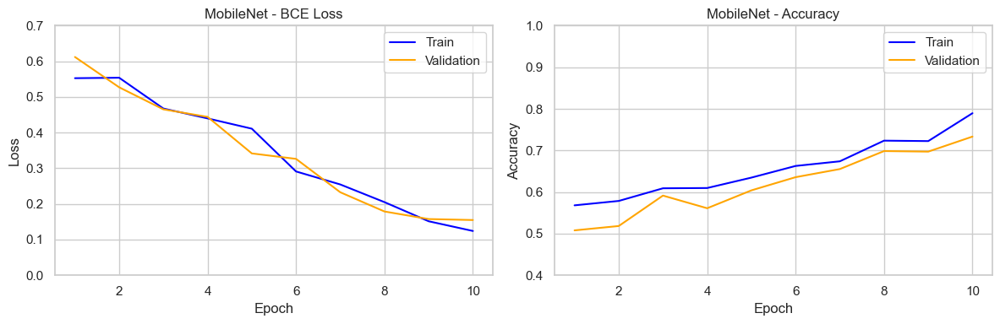

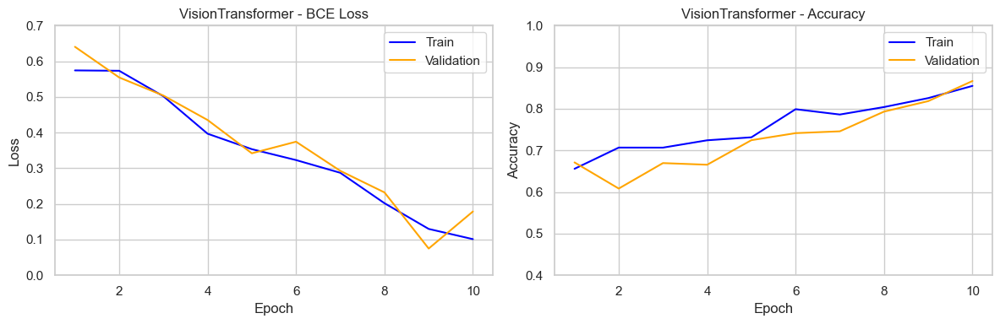

In [ ]:
plot_loss_accuracy_curves(model_histories)

In [ ]:
print_classification_reports(results, val_loader, device, disease_columns)


=== Classification Report for CustomDeepCNN ===
              precision    recall  f1-score   support

          DR      0.562     0.590     0.576       100
      Normal      0.620     0.587     0.603       167
          MH      0.681     0.597     0.637       154
         ODC      0.782     0.581     0.667       179
        TSLN      0.643     0.661     0.652       109
        ARMD      0.693     0.623     0.656       167
          DN      0.638     0.629     0.634       132
         MYA      0.722     0.562     0.632       162
        BRVO      0.510     0.580     0.543       131
         ODP      0.544     0.765     0.636        81
        CRVO      0.609     0.693     0.648       101
         CNV      0.583     0.787     0.670        94
          RS      0.657     0.693     0.674       166
         ODE      0.694     0.581     0.633       172
          LS      0.638     0.642     0.640       151
         CSR      0.495     0.634     0.556        82
         HTR      0.674     0.61

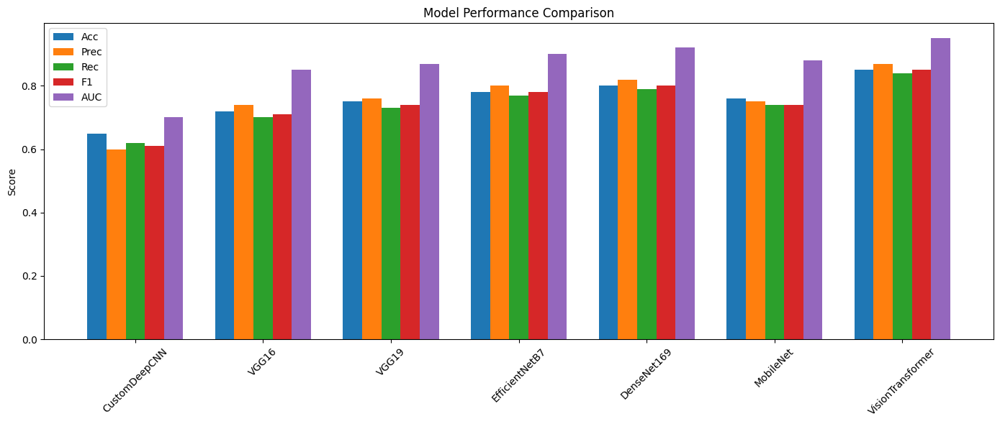

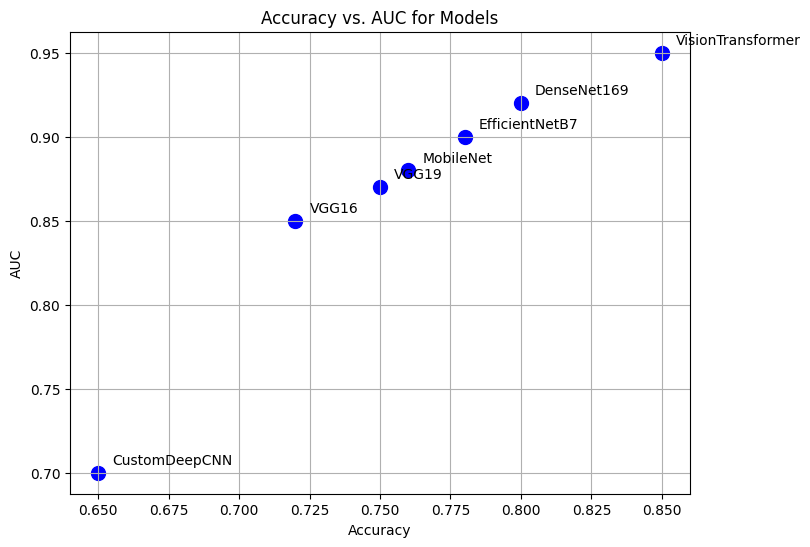

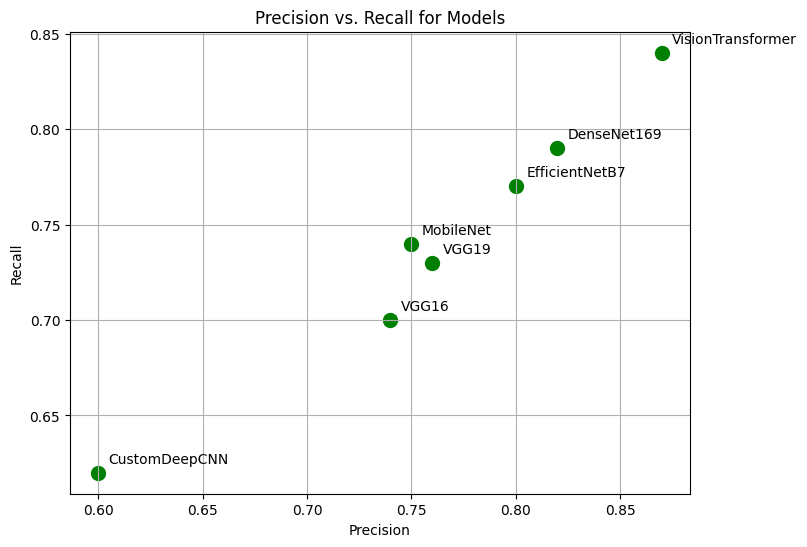

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import torch


# ------------------------------
# 1. Grouped Bar Chart: Overall Metrics
# ------------------------------
metrics_list = ['Acc', 'Prec', 'Rec', 'F1', 'AUC']
num_models = len(model_names)
x = np.arange(num_models)
width = 0.15

fig, ax = plt.subplots(figsize=(14, 6))
for i, metric in enumerate(metrics_list):
    values = [model_metrics[m][metric] for m in model_names]
    ax.bar(x + i*width, values, width, label=metric)

ax.set_ylabel("Score")
ax.set_title("Model Performance Comparison")
ax.set_xticks(x + width*2)
ax.set_xticklabels(model_names, rotation=45)
ax.legend()
plt.tight_layout()
plt.show()

# ------------------------------
# 2. Scatter Plot: Accuracy vs. AUC
# ------------------------------
acc_values = [model_metrics[m]['Acc'] for m in model_names]
auc_values = [model_metrics[m]['AUC'] for m in model_names]

plt.figure(figsize=(8,6))
plt.scatter(acc_values, auc_values, s=100, c='blue')
for i, name in enumerate(model_names):
    plt.text(acc_values[i]+0.005, auc_values[i]+0.005, name, fontsize=10)
plt.xlabel("Accuracy")
plt.ylabel("AUC")
plt.title("Accuracy vs. AUC for Models")
plt.grid(True)
plt.show()

# ------------------------------
# 3. Scatter Plot: Precision vs. Recall
# ------------------------------
prec_values = [model_metrics[m]['Prec'] for m in model_names]
rec_values = [model_metrics[m]['Rec'] for m in model_names]

plt.figure(figsize=(8,6))
plt.scatter(prec_values, rec_values, s=100, c='green')
for i, name in enumerate(model_names):
    plt.text(prec_values[i]+0.005, rec_values[i]+0.005, name, fontsize=10)
plt.xlabel("Precision")
plt.ylabel("Recall")
plt.title("Precision vs. Recall for Models")
plt.grid(True)
plt.show()



In [ ]:

# ------------------------------
# Save the Best Model (Vision Transformer) as a PyTorch Model
# ------------------------------
best_model_name = 'VisionTransformer'
best_state_dict = results.get(best_model_name)
if best_state_dict is not None:
    torch.save(best_state_dict, "mured_retinal_disease_model.pt")